# Data Mining & Machine Learning - Final Project
## Rotten Fruit Classfication

##Imports & Data load

In [189]:
!pip install imagehash

In [190]:
!pip install scikit-optimize

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import cv2
from tqdm import tqdm
from random import shuffle
import re
import math
import seaborn as sns
import imagehash
from PIL import Image
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from numpy import expand_dims
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import time


# Print the current working directory
print("Current working directory:", os.getcwd())

# Define the path to your local folders
path_kaggle = r'./Kaggle_Fruits_Data'
path_fruitnet = r'./FruitNet_Data'

# Function to load labeled fruit images
def load_labeled_fruits_data(path):
    '''
    This function takes a path of a dataset of images as input and returns three outputs:
    1) the images 2) the labels 3) the name of the image_file
    '''
    X, Y, img_names = [], [], []
    z = []
    np.random.seed(42)
    
    # Loop through directories and files
    for cata in tqdm(os.listdir(path)):
        path_main = os.path.join(path, cata)
        for img_name in os.listdir(path_main):
            img_path = os.path.join(path_main, img_name)
            
            # Skip non-image files
            if not any(img_name.lower().endswith(ext) for ext in ['.jpg', '.jpeg', '.png']):
                print(f"Skipping non-image file: {img_name}")
                continue
            
            img = cv2.imread(img_path)
            
            # Check if image is loaded properly
            if img is None:
                print(f"Warning: Unable to read image {img_path}")
                continue  # Skip if image is not loaded correctly
            
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            z.append([img, cata, img_name])
    
    print('Shuffling your data.....')
    shuffle(z)
    for images, labels, img_name in tqdm(z):
        X.append(images)
        Y.append(labels)
        img_names.append(img_name)
    
    return X, Y, img_names

# Load Kaggle data
X_k, Y_k, Z_k = load_labeled_fruits_data(path_kaggle)

# Load Fruitnet data
X_f, Y_f, Z_f = load_labeled_fruits_data(path_fruitnet)

# Function to check the amounts of fruit labels in a dataset
def check_amounts(input_list):
    for i in range(len(np.unique(np.array(input_list)))):
        print("Amount of fruits in dataset classified as '" +
              str(np.unique(np.array(input_list), return_counts=True)[0][i]) + "': " +
              str(np.unique(np.array(input_list), return_counts=True)[1][i]) + " (" +
              str(round(np.unique(np.array(input_list), return_counts=True)[1][i] / len(input_list) * 100, 2)) + "%)")
    print("")
    print("Total amount of pictures from dataset: " + str(len(input_list)))

# Check amounts for Kaggle and Fruitnet datasets
print("Kaggle dataset:")
check_amounts(Y_k)
print("")
print("Fruitnet dataset:")
check_amounts(Y_f)


Current working directory: c:\Users\User\Desktop\per\DL\Project\Rotten_Fruit_Classification\DMML_Project-20241227T094026Z-001\DMML_Project\Code


100%|██████████| 6/6 [00:12<00:00,  2.03s/it]


Shuffling your data.....


100%|██████████| 6/6 [00:40<00:00,  6.78s/it]


Shuffling your data.....


100%|██████████| 10901/10901 [00:00<00:00, 435909.47it/s]


Kaggle dataset:
Amount of fruits in dataset classified as 'apples_fresh': 395 (14.64%)
Amount of fruits in dataset classified as 'apples_rotten': 601 (22.28%)
Amount of fruits in dataset classified as 'banana_fresh': 381 (14.12%)
Amount of fruits in dataset classified as 'banana_rotten': 530 (19.64%)
Amount of fruits in dataset classified as 'oranges_fresh': 388 (14.38%)
Amount of fruits in dataset classified as 'oranges_rotten': 403 (14.94%)

Total amount of pictures from dataset: 2698

Fruitnet dataset:
Amount of fruits in dataset classified as 'apples_fresh': 1693 (15.53%)
Amount of fruits in dataset classified as 'apples_rotten': 2342 (21.48%)
Amount of fruits in dataset classified as 'banana_fresh': 1581 (14.5%)
Amount of fruits in dataset classified as 'banana_rotten': 2224 (20.4%)
Amount of fruits in dataset classified as 'oranges_fresh': 1466 (13.45%)
Amount of fruits in dataset classified as 'oranges_rotten': 1595 (14.63%)

Total amount of pictures from dataset: 10901


In [192]:
def fruit_quality_count(fruits, quality):
    '''
    This function takes fruit labels and corresponding quality labels as input and 
    returns the count of types of fruits and qualities of fruits.
    '''
    for i in range(len(np.unique(np.array(fruits)))):
        print("Total amount of " + str(np.unique(np.array(fruits), return_counts=True)[0][i]) + "s: " \
            + str(np.unique(np.array(fruits), return_counts=True)[1][i]) + " ("  \
            + str(round(np.unique(np.array(fruits), return_counts=True)[1][i] / len(fruits) * 100, 2)) + "%)")
    print("")
    for i in range(len(np.unique(np.array(quality)))):
        print("Total amount of fruits declared as '" + str(np.unique(np.array(quality), return_counts=True)[0][i]) + "': " \
            + str(np.unique(np.array(quality), return_counts=True)[1][i]) + " ("  \
            + str(round(np.unique(np.array(quality), return_counts=True)[1][i] / len(quality) * 100, 2)) + "%)")

# Extract fruits and qualities safely
fruits = []
quality = []

for label in Y_k + Y_f:
    parts = label.split("_")
    if len(parts) == 2:  # Ensure there are exactly two parts
        fruits.append(parts[0])  # Fruit type
        quality.append(parts[1])  # Quality
    else:
        print(f"Skipping invalid label: {label}")

# Call the function
fruit_quality_count(fruits, quality)


Total amount of appless: 5031 (37.0%)
Total amount of bananas: 4716 (34.68%)
Total amount of orangess: 3852 (28.33%)

Total amount of fruits declared as 'fresh': 5904 (43.41%)
Total amount of fruits declared as 'rotten': 7695 (56.59%)


## Exploratory Analysis

In [ ]:
def fruitlist_generator(X,Y,catList,L):
  '''
  Creates a list with length L of fruit from the given categories
  '''
  images = []
  labels = []
  x = L//len(catList)
  temp = pd.DataFrame({"data":X,"label":Y})
  for cat in catList:
    filtered = temp[temp["label"].str.contains(cat)]
    filtered.sample(frac=1)
    images = images + filtered["data"].values.tolist()[:x]
    labels = labels + filtered["label"].values.tolist()[:x]
  return images, labels

In [ ]:
def show_subplot(X,Y=None):
  '''
  creates a plot of 6x6 images
  '''
  f, ax= plt.subplots(6,6, figsize=(40,60))
  for i,img in enumerate(X[:36]):
    ax[i//6][i%6].imshow(img, aspect='auto')
    ax[i//6][i%6].set_axis_off()
    if isinstance(Y,np.ndarray) or isinstance(Y,list) and len(Y) == len(X):
      ax[i//6][i%6].set_title(Y[i], fontsize=28)
  plt.show()


In [195]:
# Generate Fruitlist ...

# ... for Kaggle dataset
plot_X_k,plot_Y_k  = fruitlist_generator(X_k,Y_k,["apples_fresh","apples_rotten","banana_fresh","banana_rotten","oranges_fresh","oranges_rotten"],36)

# ... for FruitNet dataset
plot_X_f,plot_Y_f  = fruitlist_generator(X_f,Y_f,["apples_fresh","apples_rotten","banana_fresh","banana_rotten","oranges_fresh","oranges_rotten"],36)

print(f"Length of plot_X_k: {len(plot_X_k)}")
print(f"Sample of plot_Y_k: {plot_Y_k[:5]}")

Length of plot_X_k: 36
Sample of plot_Y_k: ['apples_fresh', 'apples_fresh', 'apples_fresh', 'apples_fresh', 'apples_fresh']


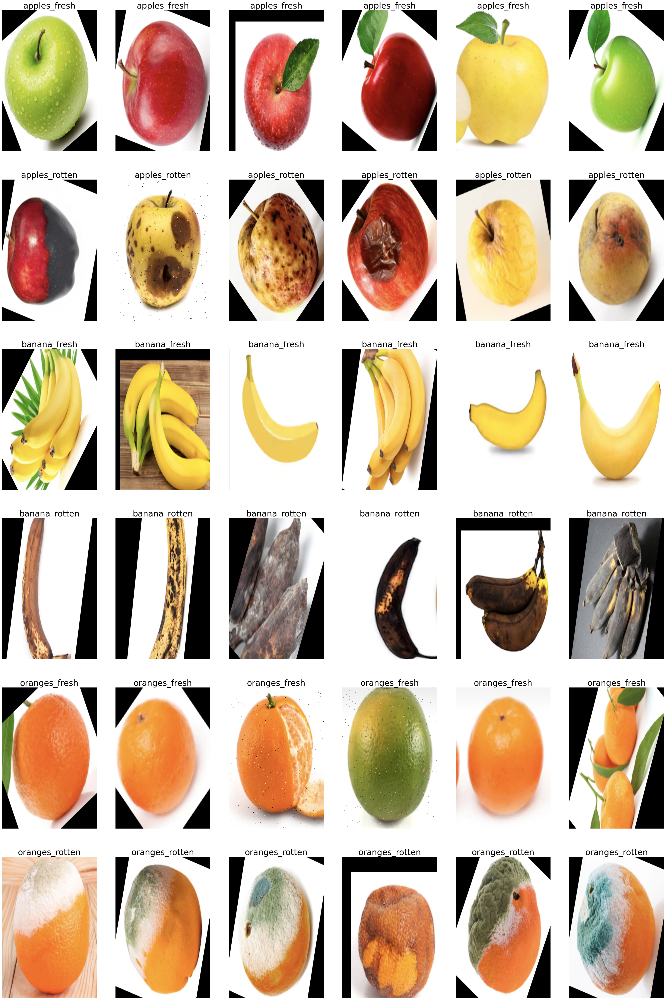

In [196]:
# Kaggle sample images plot by categories
show_subplot(plot_X_k,plot_Y_k)

In [ ]:
# As you can see that quite some of the images are already augmented.

In [ ]:
# Look at unique file names in Kaggle dataset
beginning = np.array([])

for file_name in Z_k:
    match = re.search(r"[a-z]*", file_name, re.IGNORECASE)
    if match:  # Check if the regex found a match
        beginning = np.append(beginning, match.group())

print(np.unique(beginning))

# We see that the augmented pictures we identified in the subplot above have 'rotated', 'saltandpepper', 'translation' or 'vertical' as beginning of their name
# I will use this information later on to drop out the augmented versions in order to augment the images ourselves.

['Screen' 'rotated' 'saltandpepper' 'translation' 'vertical']


In [199]:
def show_subplot_60(X,Y=None):
  '''
  creates a plot of 6x6 images
  '''
  f, ax= plt.subplots(6,6, figsize=(40,60))
  for i,img in enumerate(X[:60]):
    ax[i//6][i%6].imshow(img, aspect='auto')
    ax[i//6][i%6].set_axis_off()
    if isinstance(Y,np.ndarray) or isinstance(Y,list) and len(Y) == len(X):
      ax[i//6][i%6].set_title(Y[i], fontsize=28)
  plt.show()

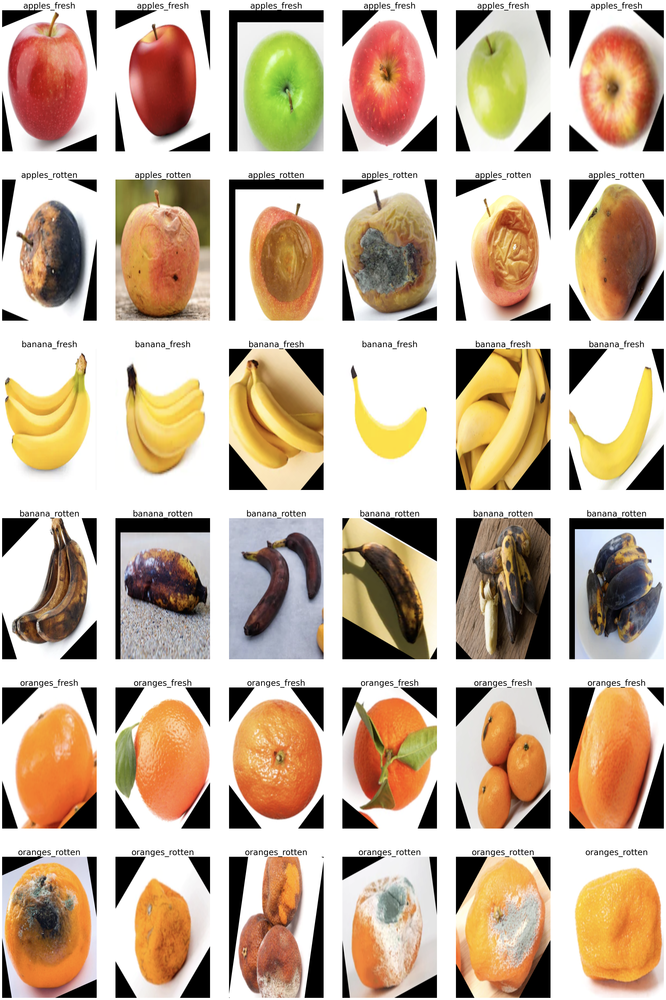

In [200]:
# FruitNet image plot by categories
show_subplot_60(plot_X_f,plot_Y_f)

In [ ]:
# Look at unique file names in Kaggle dataset
beginning = np.array([])
for file_name in Z_k:
  beginning = np.append(beginning, re.search(r"[a-z]*", file_name, re.IGNORECASE).group())
print(np.unique(beginning))


# We see that the augmented pictures we identified in the subplot above have 'rotated', 'saltandpepper', 'translation' or 'vertical' as beginning of their name
# I will use this information later on to drop out the augmented Versions in order to augment the images ourselves
# Unaugmented images start with "Screen" ("Screen_shot" but only all characters of the beginning until the first character that is not a letter are printed)

['Screen' 'rotated' 'saltandpepper' 'translation' 'vertical']


In [202]:
def show_subplot_60(X,Y=None):
  '''
  creates a plot of 6x6 images
  '''
  f, ax= plt.subplots(6,6, figsize=(40,60))
  for i,img in enumerate(X[:60]):
    ax[i//6][i%6].imshow(img, aspect='auto')
    ax[i//6][i%6].set_axis_off()
    if isinstance(Y,np.ndarray) or isinstance(Y,list) and len(Y) == len(X):
      ax[i//6][i%6].set_title(Y[i], fontsize=28)
  plt.show()

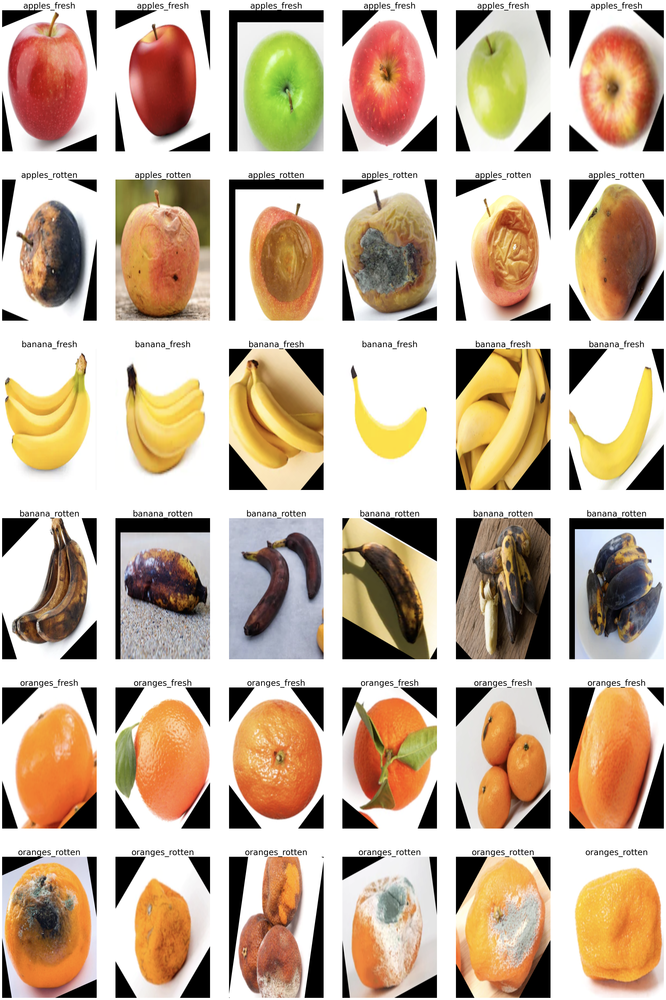

In [203]:
# FruitNet image plot by categories
show_subplot_60(plot_X_f,plot_Y_f)

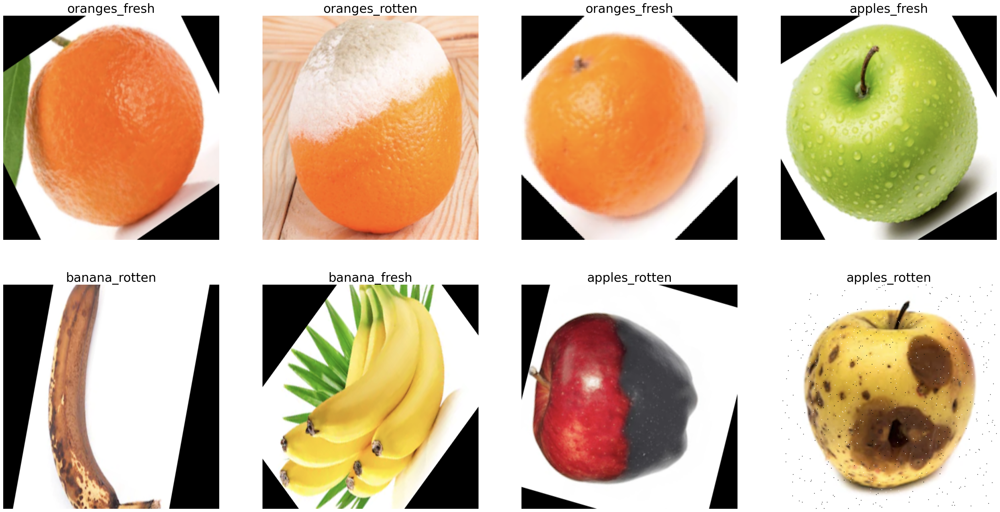

['Screen' 'rotated' 'saltandpepper' 'translation' 'vertical']


In [204]:
# Now I print one sample of a (supposed) augmented image

augmented = []
augmented_label = []
for i in range(len(Z_k)):
  #if "Screen Shot 2018-06-08 at 5.00.50 PM" in Z_k[i]:
  #if "Screen Shot 2018-06-08 at 5.07.05 PM" in Z_k[i]:
  #if "Screen Shot 2018-06-08" in Z_k[i]:
  if "Screen Shot 2018" in Z_k[i]:
    augmented.append(X_k[i])
    augmented_label.append(Y_k[i])
def show_subplot(X,Y=None):
        f, ax= plt.subplots(2,4, figsize=(40,20))
        for i,img in enumerate(X[:8]):
            ax[i//4][i%4].imshow(img, aspect='auto')
            ax[i//4][i%4].set_axis_off()
            if isinstance(Y,np.ndarray) or isinstance(Y,list) and len(Y) == len(X):
                ax[i//4][i%4].set_title(Y[i], fontsize=28)
        plt.show()
show_subplot(augmented, augmented_label)
print(np.unique(beginning))

In [ ]:
def size_aspect_ratio_scatter(X, Y):
  '''
  Creates a scatterplot that plots square root size vs aspect ratio
  values are colored by the given label
  '''
  size = [math.sqrt(len(img)*len(img[0])) for img in X]
  aspect_ratio = [len(img)/len(img[0]) for img in X]
  df = pd.DataFrame({'size': size, 'aspect ratio': aspect_ratio, 'label':Y})
  sns.scatterplot(x='size', y='aspect ratio', data=df, hue='label')
  plt.show()
  return

In [206]:
def darken_color(color, amount=0.5):
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

def average_RGB_boxplot(X, Y):
  avg_RGB = [np.mean(img) for img in tqdm(X)]
  print(len(avg_RGB))
  df = pd.DataFrame({'average RGB value':avg_RGB, 'label':Y})
  sns.boxplot(x='label', y='average RGB value', data=df, order=["apples_fresh","apples_rotten","banana_fresh","banana_rotten","oranges_fresh","oranges_rotten"], palette=['red', darken_color('red',1.2), 'yellow', darken_color('yellow',1.2), 'green', darken_color("green",1.1), 'lightgreen', darken_color("lightgreen",1.6), 'orange', darken_color("orange",1.2)])
  plt.xticks(rotation=340,ha="left")
  plt.show()

In [207]:
# Create joined dataset for general anaylsis purposes
X_joined = X_k + X_f
Y_joined = Y_k + Y_f
quality_labels = [label.split("_")[1] for label in Y_joined]

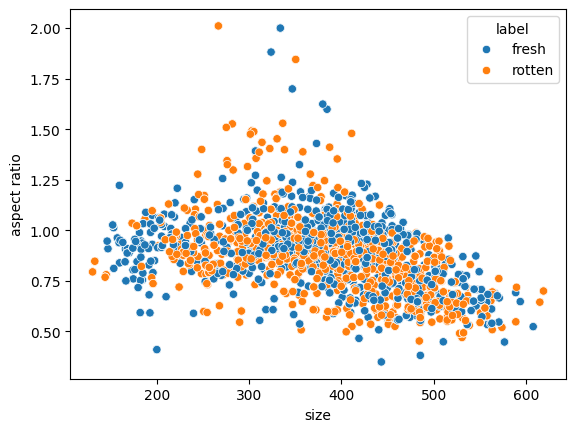

In [209]:
# Plot size against aspect ratio of all pictures
size_aspect_ratio_scatter(X_joined, quality_labels)

100%|██████████| 13599/13599 [00:04<00:00, 3055.35it/s]
C:\Users\User\AppData\Local\Temp\ipykernel_2180\3494425587.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='label', y='average RGB value', data=df, order=["apples_fresh","apples_rotten","banana_fresh","banana_rotten","oranges_fresh","oranges_rotten"], palette=['red', darken_color('red',1.2), 'yellow', darken_color('yellow',1.2), 'green', darken_color("green",1.1), 'lightgreen', darken_color("lightgreen",1.6), 'orange', darken_color("orange",1.2)])
C:\Users\User\AppData\Local\Temp\ipykernel_2180\3494425587.py:16: UserWarning: The palette list has more values (10) than needed (6), which may not be intended.
  sns.boxplot(x='label', y='average RGB value', data=df, order=["apples_fresh","apples_rotten","banana_fresh","banana_rotten","oranges_fresh","oranges_rotten"], palette=['re

13599


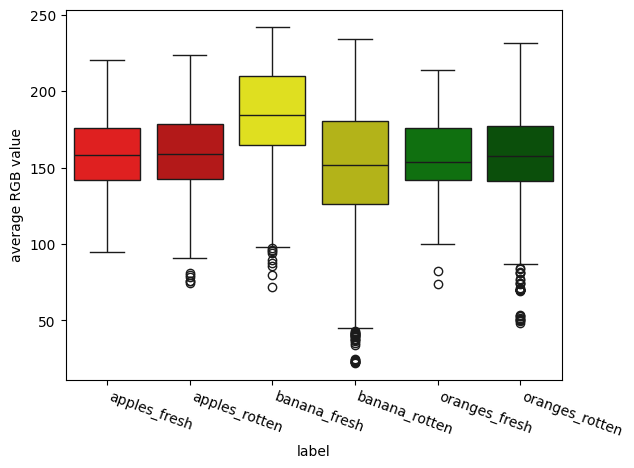

In [210]:
# Boxplot of average RGB values
average_RGB_boxplot(X_joined,Y_joined)

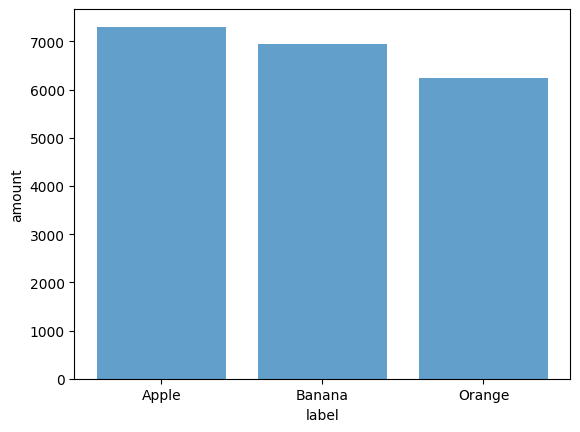

In [ ]:
# Barplot of different fruits
counts = [7306,6950,6237]
labels = ["Apple","Banana","Orange"]
plt.figure()
plt.bar(range(len(counts)), counts, alpha = .7)
plt.xticks(range(len(counts)), labels)#, rotation = 30)
plt.xlabel("label")
plt.ylabel("amount")
plt.show()

## Preprocessing

### Data Filtering

In [ ]:
# Image filtering
def augmented_filter(X, Y, img_names):  # only for Kaggle dataset
    """
    Filters out pre-augmented images with help of the file name
    """
    if len(X) != len(Y) or len(Y) != len(img_names):
        raise ValueError("Lengths of X, Y, and img_names must be the same")

    temp = pd.DataFrame({"data": X, "label": Y, "img_name": img_names})
    filtered = temp[temp["img_name"].str.startswith("Screen Shot")]
    print("Number of filtered-out entries:", len(X) - len(filtered))
    return filtered["data"].values.tolist(), filtered["label"].values.tolist()


def duplicate_filter(X, Y):
    """
    Filters out full duplicates with help of the image hash
    """
    pHash = [imagehash.phash(Image.fromarray(img)) for img in X]
    temp = pd.DataFrame({"data": X, "label": Y, "perceptual hash": pHash})
    filtered = temp.drop_duplicates(subset="perceptual hash")
    print("Number of filtered-out entries:", len(X) - len(filtered))
    return filtered["data"].values.tolist(), filtered["label"].values.tolist()


def aspect_ratio_filter(X, Y):
    """
    Filters out aspect ratio anomalies
    """
    aspect_ratios = [img.shape[0] / img.shape[1] for img in X]
    sqrt_sizes = [math.sqrt(img.shape[0] * img.shape[1]) for img in X]
    temp = pd.DataFrame({"data": X, "label": Y, "aspect ratio": aspect_ratios, "size": sqrt_sizes})
    filtered = temp.loc[(temp["aspect ratio"] >= 0.25) | (temp["size"] > 300)]
    filtered = filtered.loc[(filtered["aspect ratio"] <= 4) | (filtered["size"] > 300)]
    print("Number of filtered-out entries:", len(X) - len(filtered))
    return filtered["data"].values.tolist(), filtered["label"].values.tolist()


def RGB_filter(X, Y):
    """
    Filters out RGB anomalies
    """
    avg_RGB = [np.mean(img, axis=(0, 1)) for img in X]
    avg_R = [RGB[0] for RGB in avg_RGB]
    avg_G = [RGB[1] for RGB in avg_RGB]
    avg_B = [RGB[2] for RGB in avg_RGB]
    temp = pd.DataFrame({"data": X, "label": Y, "average R": avg_R, "average G": avg_G, "average B": avg_B})
    filtered = temp.loc[(temp["average R"] >= 5) & (temp["average R"] <= 250)]
    filtered = filtered.loc[(filtered["average G"] >= 5) & (filtered["average G"] <= 250)]
    filtered = filtered.loc[(filtered["average B"] >= 5) & (filtered["average B"] <= 250)]
    print("Number of filtered-out entries:", len(X) - len(filtered))
    return filtered["data"].values.tolist(), filtered["label"].values.tolist()  

In [214]:
# Check the lengths of X_k, Y_k, and Z_k
print(f"Length of X_k: {len(X_k)}")
print(f"Length of Y_k: {len(Y_k)}")
print(f"Length of Z_k: {len(Z_k)}")

# Check if the lengths are the same
if len(X_k) != len(Y_k) or len(Y_k) != len(Z_k):
    print("Lengths do not match!")
else:
    # If lengths match, proceed with filtering
    X_k, Y_k = augmented_filter(X_k, Y_k, Z_k)  # Apply the filter once

# Check the lengths again after filtering
print(f"Length of X_k: {len(X_k)}")
print(f"Length of Y_k: {len(Y_k)}")
print(f"Length of Z_k: {len(Z_k)}")


Length of X_k: 2698
Length of Y_k: 2698
Length of Z_k: 2698
Number of filtered-out entries: 2369
Length of X_k: 329
Length of Y_k: 329
Length of Z_k: 2698


In [215]:
# Filter out duplicates... 

# ... from Kaggle dataset
X_k,Y_k = duplicate_filter(X_k,Y_k)

# ... from Fruitnet dataset
X_f,Y_f = duplicate_filter(X_f,Y_f)

Number of filtered-out entries: 0
Number of filtered-out entries: 791


In [216]:
# Filter out pictures which have a smaller (square root) size than 300 and an aspect ratio below 0.25 or above 4 ...

# ... from Kaggle dataset
X_k,Y_k = aspect_ratio_filter(X_k,Y_k)

# ... from Fruitnet dataset
X_f,Y_f = aspect_ratio_filter(X_f,Y_f)

Number of filtered-out entries: 0
Number of filtered-out entries: 0


In [217]:
# Filter out too bright or dark pictures (due to too high average RGB values)...

# ... from Kaggle dataset
X_k,Y_k = RGB_filter(X_k,Y_k)

# ... from Fruitnet dataset
X_f,Y_f = RGB_filter(X_f,Y_f)

Number of filtered-out entries: 8
Number of filtered-out entries: 65


### Data Normalization

In [157]:
# Resize images
def resize(X,V):
  """
  Downsizes images of a list X to a given width and height of V
  """
  resized = []
  for img in X:
    resized.append(cv2.resize(img, (V,V), interpolation=cv2.INTER_CUBIC))
  return resized

# Rescale images
def rescale(X):
  return [img/255 for img in X]

In [218]:
# Downsize images to 128x128...

# ... Kaggle dataset
X_k = resize(X_k, 128)

# ... Fruitnet dataset
X_f = resize(X_f, 128)

In [219]:
# Rescale pictures ... ACHTUNG, CRASH! <-- Money helped

# ... from Kaggle dataset
X_k= rescale(X_k)

# ... from Fruitnet dataset
X_f = rescale(X_f)


In [220]:
# Merge datasets 
X = X_k + X_f
Y = Y_k + Y_f

In [ ]:
# Check amount of 
print("Amount of pictures left from Kaggle dataset: " + str(len(X_k)))
print("Amount of pictures left from Fruitnet dataset: " + str(len(X_f)))
print("Amount of pictures in resulting total dataset: " + str(len(X)))

Amount of pictures left from Kaggle dataset: 321
Amount of pictures left from Fruitnet dataset: 10045
Amount of pictures in resulting total dataset: 10366


In [ ]:
# Assuming Y is the list of labels, split them and encode
Y_fresh = [label.split("_")[1] for label in Y]
Y_fresh_encoded = LabelEncoder().fit_transform(Y_fresh)

# Print the encoded labels
print("Encoded Y_fresh:")
print(Y_fresh_encoded)

Encoded Y_fresh:
[1 1 0 ... 0 1 0]


In [ ]:
# Train-Test-Split: Train = 80%, Test = 20%
X = np.array(X)
X_train, X_test, y_train, y_test = train_test_split(X, Y_fresh_encoded, test_size=0.2, random_state=1)

In [224]:
# Train-Validation-Split: Train = 70%, Validation = 10%
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.125, random_state=1) # 0.125 x 0.8 = 0.1

#### PCA

In [ ]:
def Dim_Reduction(X):
  '''
  Function to apply PCA to the given RGB image data
  returns reconstructed images
  '''
  reconstructed_X = []
  for img in tqdm(X):
    B,G,R = cv2.split(img)
    pca_r = PCA(n_components=0.99, whiten=True, random_state=42)
    reduced_R = pca_r.fit_transform(np.array(R))
    #print("Red Dimension reduced from", img.shape,"to",reduced_R.shape)
    pca_g = PCA(n_components=0.99, whiten=True, random_state=42)
    reduced_G = pca_g.fit_transform(np.array(G))
    #print("Blue Dimension reduced from", img.shape,"to",reduced_G.shape)
    pca_b = PCA(n_components=0.99, whiten=True, random_state=42)
    reduced_B = pca_b.fit_transform(np.array(B))
    #print("Green Dimension reduced from", img.shape,"to",reduced_B.shape)
    reconstructed_r = pca_r.inverse_transform(reduced_R)
    reconstructed_g = pca_g.inverse_transform(reduced_G)
    reconstructed_b = pca_b.inverse_transform(reduced_B)
    reconstructed_X.append(cv2.merge((reconstructed_b, reconstructed_g, reconstructed_r)))
  return reconstructed_X

  0%|          | 0/10366 [00:00<?, ?it/s]

100%|██████████| 10366/10366 [08:50<00:00, 19.53it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.08038666930528138..1.1369985308173975].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.1261701834241048..1.083393972272965].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06800934202105846..1.1092616612033313].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06811454486529855..1.1567322121539818].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.04883939651031699..1.111068570791558].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.015672076

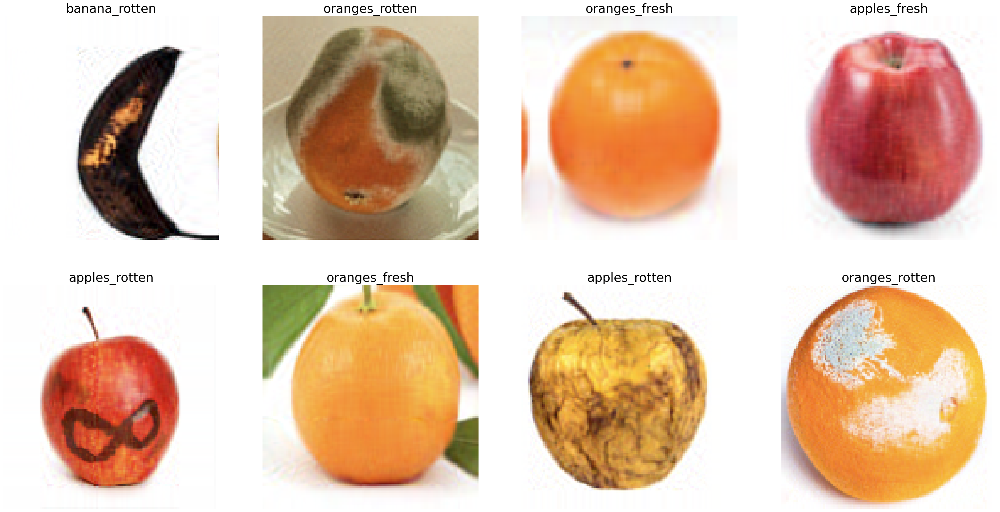

In [226]:
# Plot some reconstructed images
reconstructed = Dim_Reduction(X)
len(reconstructed)
show_subplot(reconstructed,Y)

### Augmentation

In [ ]:
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    zoom_range=0.2
)

In [228]:
# Data Augmentation func
def augment(X, Y):
  aug_X = []                      # list of augmented pictures, each picture will be augmented two times (TBD!)
  aug_Y = []                      # list of respective labels for augmented pictures
  for i in range(len(X)): 
    pic_array = expand_dims(X[i],0)
    
    # Create an iterator
    it = datagen.flow(pic_array)

    # Generate batch of images
    for j in range(1):      # reduced to 1 to save RAM
    
        # convert to unsigned integers
        image = next(it)[0].astype('uint8')
        
        # Append image and respective label to lists
        aug_X.append(image)
        aug_Y.append(Y[i]) # 0 variabel 
  aug_X = rescale(aug_X)
  return aug_X, aug_Y

In [187]:
# Data Augmentation

# Train data
aug_X_train, aug_y_train = augment(X_train, y_train)

# Valdidation data
aug_X_valid, aug_y_valid = augment(X_valid, y_valid)

# Test data
aug_X_test, aug_y_test = augment(X_test, y_test)

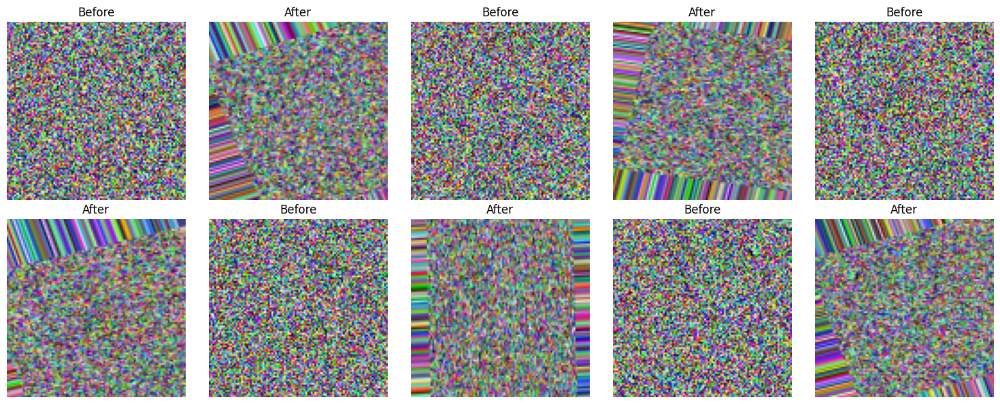

In [188]:
# plot some augmented pictures
images = [X_train[0],aug_X_train[0],X_train[1],aug_X_train[1],X_train[2],aug_X_train[2],X_train[3],aug_X_train[3],X_train[4],aug_X_train[4],X_train[5],aug_X_train[5],X_train[6],aug_X_train[6],X_train[7],aug_X_train[7],X_train[8],aug_X_train[8],X_train[9],aug_X_train[9],X_train[10],aug_X_train[10],X_train[11],aug_X_train[11],X_train[12],aug_X_train[12],X_train[13],aug_X_train[13],X_train[14],aug_X_train[14],X_train[15],aug_X_train[15],X_train[16],aug_X_train[16],X_train[17],aug_X_train[17]]
labels = ["Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After","Before","After"]
show_subplot(images,labels)

In [133]:
images = []
for i in range(18):  # Replace 18 with the desired range or len(X_train)
    images.append(X_train[i])
    images.append(aug_X_train[i])

print("Length of images:", len(images))

Length of images: 36


In [134]:
# add augmented data to original data
# Train data
X_train = np.concatenate((X_train, np.array(aug_X_train)), axis=0)
y_train = np.concatenate((y_train, np.array(aug_y_train)), axis=0)
## shuffle
np.random.seed(42)
np.random.shuffle(X_train)
np.random.seed(42)
np.random.shuffle(y_train)

# Validation data
X_valid = np.concatenate((X_valid, np.array(aug_X_valid)), axis=0)
y_valid = np.concatenate((y_valid, np.array(aug_y_valid)), axis=0)
## shuffle
np.random.seed(42)
np.random.shuffle(X_valid)
np.random.seed(42)
np.random.shuffle(y_valid)

# test data
X_test = np.concatenate((X_test, np.array(aug_X_test)), axis=0)
y_test = np.concatenate((y_test, np.array(aug_y_test)), axis=0)

## shuffle
np.random.seed(42)
np.random.shuffle(X_test)
np.random.seed(42)
np.random.shuffle(y_test)

In [135]:
print("Number of train instances after Augmentation:", len(X_train))
print("Number of validation instances after Augmentation:", len(X_valid))
print("Number of test instances after Augmentation:", len(X_test))

Number of train instances after Augmentation: 14512
Number of validation instances after Augmentation: 2074
Number of test instances after Augmentation: 4148


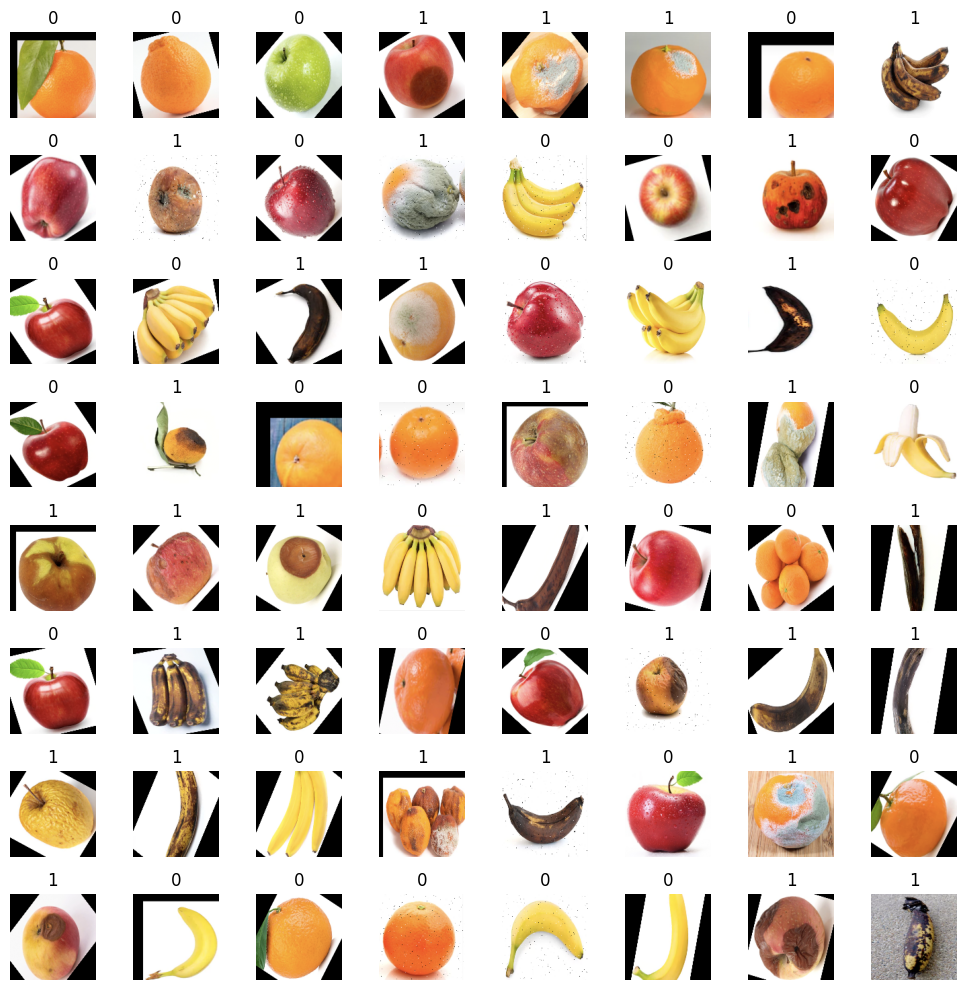

In [ ]:
# Updated show_subplot function to handle subsets of data
def show_subplot(images, labels, num_examples=64):
    """
    Plots a subset of the images with corresponding labels.
    num_examples: The number of images to display (must be a perfect square for grid layout).
    """
    if num_examples > len(images):
        num_examples = len(images)
    grid_size = int(np.sqrt(num_examples))
    
    plt.figure(figsize=(10, 10))
    for i in range(num_examples):
        plt.subplot(grid_size, grid_size, i + 1)
        plt.imshow(images[i], cmap='gray')  # Adjust 'cmap' if grayscale images are expected
        plt.title(labels[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Plot some examples from final train data
show_subplot(X_train,y_train)

## Modelling

### General Function

In [ ]:
# import needed libraries
import keras 
from keras.layers import Dense,Dropout, Conv2D,MaxPooling2D , Activation, Flatten, BatchNormalization, SeparableConv2D
from keras.models import Sequential
from keras.models import Model, load_model
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam

In [231]:
def plot_training_history(history):
  '''
  Function plots training history for a model
  '''
  plt.figure(1, figsize = (20, 12))
  plt.subplot(1,2,1)
  plt.xlabel("Epochs")
  plt.ylabel("Loss")
  plt.plot( history.history["loss"], label = "Training Loss")
  plt.plot( history.history["val_loss"], label = "Validation Loss")
  plt.grid(True)
  plt.legend()

  plt.subplot(1,2,2)
  plt.xlabel("Epochs")
  plt.ylabel("Accuracy")
  plt.plot( history.history["accuracy"], label = "Training Accuracy")
  plt.plot( history.history["val_accuracy"], label = "Validation Accuracy")
  plt.grid(True)
  plt.legend()

### CNN1

In [232]:
# Create CNN with 8 layers
model = keras.models.Sequential([
    keras.layers.Conv2D(32, kernel_size=3, padding="same", activation="relu"),
    keras.layers.Conv2D(64, kernel_size=3, padding="same", activation="relu"),
    keras.layers.MaxPool2D(),
    keras.layers.Flatten(),
    keras.layers.Dropout(0.25),
    keras.layers.Dense(128, activation="relu"),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(1, activation="sigmoid")
])

In [233]:
# Compile model
model.compile(loss="binary_crossentropy", optimizer="adam",
              metrics=["accuracy"])

In [ ]:
# Measure the time
start_time = time.time()

# Set random seed
tf.random.set_seed(42)

# Fit the model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_valid, y_valid))

# Measure the elapsed time
elapsed_time = time.time() - start_time
print(f"Elapsed Time: {elapsed_time:.2f} seconds")


Epoch 1/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 103s 441ms/step - accuracy: 0.6641 - loss: 1.6210 - val_accuracy: 0.8785 - val_loss: 0.2898
Epoch 2/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 100s 441ms/step - accuracy: 0.8663 - loss: 0.3244 - val_accuracy: 0.8968 - val_loss: 0.2630
Epoch 3/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 100s 441ms/step - accuracy: 0.8993 - loss: 0.2476 - val_accuracy: 0.9161 - val_loss: 0.2252
Epoch 4/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 98s 431ms/step - accuracy: 0.9231 - loss: 0.2018 - val_accuracy: 0.9190 - val_loss: 0.2186
Epoch 5/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 100s 441ms/step - accuracy: 0.9227 - loss: 0.1907 - val_accuracy: 0.9190 - val_loss: 0.2118
Epoch 6/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 100s 438ms/step - accuracy: 0.9417 - loss: 0.1494 - val_accuracy: 0.9190 - val_loss: 0.2136
Epoch 7/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 99s 437ms/step - accuracy: 0.9438 - loss: 0.1504 - val_accuracy: 0.9103 - val_loss: 0.2372
Epoch 8/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 100s 438ms/step - accuracy: 0.9522 - l

In [235]:
# print model summary
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 128, 128, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 128, 128, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 262144)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 262144)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    33,554,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 100,722,245 (384.22 MB)

 Trainable params: 33,574,081 (128.07 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 67,148,164 (256.15 MB)

In [ ]:
# plot training history

def plot_training_history(history, figsize=(6, 4)):  # Add figsize parameter
    """
    Plots the training and validation loss and accuracy from the history object.

    Args:
    - history: History object returned by model.fit().
    - figsize: Tuple, size of the plot (width, height). Default is (6, 4).
    """
    # Retrieve metrics
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(1, len(acc) + 1)

    # Create subplots
    plt.figure(figsize=figsize)  # Use the figsize parameter

    # Plot accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs, acc, 'bo-', label='Training Accuracy')
    plt.plot(epochs, val_acc, 'ro-', label='Validation Accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Plot loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs, loss, 'bo-', label='Training Loss')
    plt.plot(epochs, val_loss, 'ro-', label='Validation Loss')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()  # Adjust layout for clarity
    plt.show()

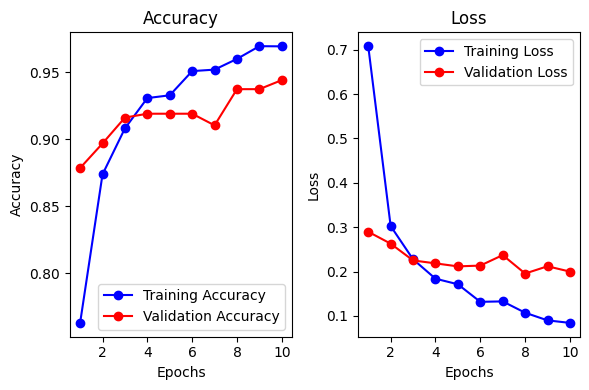

In [238]:
plot_training_history(history, figsize=(6, 4))

In [239]:
# model evaluation
model.evaluate(X_test, y_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 4s 60ms/step - accuracy: 0.9239 - loss: 0.1931


[0.17471881210803986, 0.9353905320167542]

In [ ]:
# reload fitted model
#CNN1 = load_model('./Final_Models/CNN1.h5')

# Load the model
CNN1 = load_model('./Final_Models/CNN1.h5')

# Recompile the model to ensure optimizer and metrics are set
CNN1.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Summary of the model to confirm loading
CNN1.summary()

C:\Users\User\AppData\Roaming\Python\Python311\site-packages\keras\src\optimizers\base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 128, 128, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 128, 128, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 262144)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 262144)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    33,554,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 33,574,081 (128.07 MB)

 Trainable params: 33,574,081 (128.07 MB)

 Non-trainable params: 0 (0.00 B)

In [241]:
# Generate predictions for test data
y_pred_CNN1 = CNN1.predict(X_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 4s 58ms/step


In [242]:
# print classification report
print(classification_report(y_test, y_pred_CNN1.round()))

              precision    recall  f1-score   support

           0       0.68      0.81      0.74       883
           1       0.83      0.72      0.77      1191

    accuracy                           0.76      2074
   macro avg       0.76      0.76      0.75      2074
weighted avg       0.77      0.76      0.76      2074



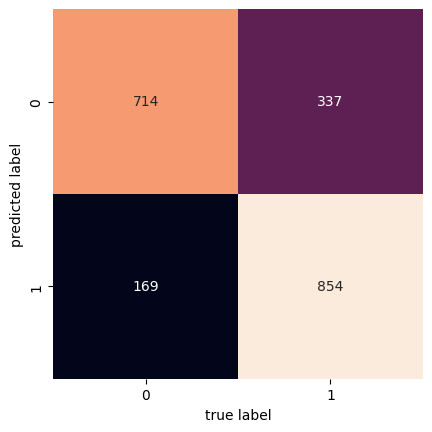

In [243]:
# plot the confusion matrix
mat = confusion_matrix(y_test, y_pred_CNN1.round())
sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False)
plt.xlabel('true label')
plt.ylabel('predicted label');

### CNN2

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPooling2D, Dropout, SeparableConv2D, Flatten, Dense
from keras.models import load_model

# Create CNN with 19 layers
model = Sequential()

# Initial Conv Layer
model.add(Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(128, 128, 3)))
model.add(BatchNormalization())
model.add(MaxPooling2D((2, 2)))
model.add(Dropout(0.2))  # To reduce overfitting

# Separable Conv Layers
model.add(SeparableConv2D(64, (3, 3), padding='same', activation='relu', depthwise_initializer='he_uniform', pointwise_initializer='he_uniform'))
model.add(BatchNormalization())
model.add(MaxPooling2D((2, 2)))  # Adjusted pooling size to prevent large reductions in size
model.add(Dropout(0.3))

# Further Conv Layers
model.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D((2, 2)))
model.add(Dropout(0.5))

# Flattening
model.add(Flatten())

# Fully Connected Layers
model.add(Dense(64, activation='relu', kernel_initializer='he_uniform'))
model.add(Dropout(0.2))

# Output Layer
model.add(Dense(1, activation='sigmoid'))  # For binary classification

In [246]:
# print model summary
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)               │ (None, 128, 128, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 128, 128, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ separable_conv2d_1              │ (None, 64, 64, 64)     │         4,736 │
│ (SeparableConv2D)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 32, 32, 64)     │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │     1,048,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,204,161 (4.59 MB)

 Trainable params: 1,203,521 (4.59 MB)

 Non-trainable params: 640 (2.50 KB)

In [247]:
# Compile model
model.compile(loss='binary_crossentropy', optimizer="adam",metrics=["accuracy"])

In [ ]:
# Measure the time
start_time = time.time()

# Set random seed
tf.random.set_seed(42)

# Fit the model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_valid, y_valid))

# Measure the elapsed time
elapsed_time = time.time() - start_time
print(f"Elapsed Time: {elapsed_time:.2f} seconds")


Epoch 1/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 133s 565ms/step - accuracy: 0.7863 - loss: 0.6872 - val_accuracy: 0.5593 - val_loss: 2.6828
Epoch 2/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 550ms/step - accuracy: 0.9082 - loss: 0.2585 - val_accuracy: 0.7608 - val_loss: 2.3218
Epoch 3/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 549ms/step - accuracy: 0.9159 - loss: 0.2166 - val_accuracy: 0.7213 - val_loss: 1.5310
Epoch 4/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 550ms/step - accuracy: 0.9424 - loss: 0.1423 - val_accuracy: 0.8775 - val_loss: 0.3665
Epoch 5/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 550ms/step - accuracy: 0.9366 - loss: 0.1653 - val_accuracy: 0.7869 - val_loss: 0.7534
Epoch 6/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 550ms/step - accuracy: 0.9496 - loss: 0.1305 - val_accuracy: 0.7493 - val_loss: 4.1033
Epoch 7/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 125s 549ms/step - accuracy: 0.9600 - loss: 0.1004 - val_accuracy: 0.8910 - val_loss: 0.3167
Epoch 8/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 124s 546ms/step - accuracy: 0.9654 -

In [249]:
# Plot training history function (ensure this is already defined)
def plot_training_history(history, figsize=(6, 4)):
    # Extract history data
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']
    
    # Create subplots
    plt.figure(figsize=figsize)

    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(loss, label='Train Loss')
    plt.plot(val_loss, label='Val Loss')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(accuracy, label='Train Accuracy')
    plt.plot(val_accuracy, label='Val Accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

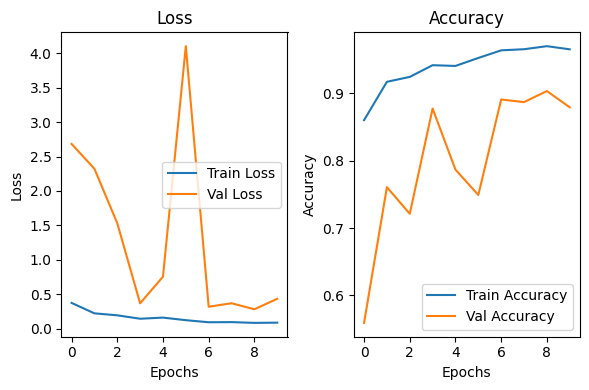

In [250]:
# Plot the training history after model fitting
plot_training_history(history, figsize=(6, 4))

In [251]:
# model evaluation
model.evaluate(X_test, y_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 7s 105ms/step - accuracy: 0.8640 - loss: 0.5231


[0.4568147361278534, 0.8809064626693726]

In [ ]:
model.save('./Final_Models/CNN2.h5')  # creates a HDF5 file 'CNN2.h5'
del model  # deletes the existing model

# returns a compiled model
# identical to the previous one
CNN2 = load_model('./Final_Models/CNN2.h5')

In [333]:
# Generate predictions
y_pred_CNN2 = CNN2.predict(X_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 36s 557ms/step


In [335]:
# Print classification report
print(classification_report(y_test, y_pred_CNN2.round()))

              precision    recall  f1-score   support

           0       0.98      0.95      0.96       883
           1       0.96      0.99      0.97      1191

    accuracy                           0.97      2074
   macro avg       0.97      0.97      0.97      2074
weighted avg       0.97      0.97      0.97      2074



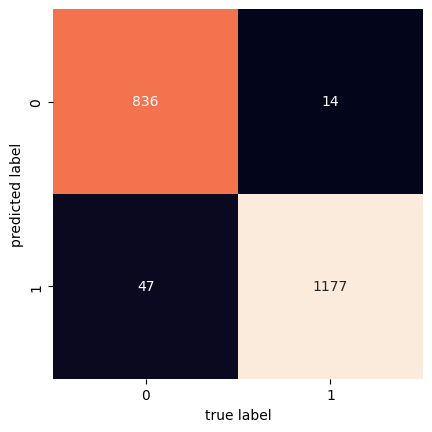

In [336]:
# plot the confusion matrix:
mat = confusion_matrix(y_test, y_pred_CNN2.round())
sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False)
plt.xlabel('true label')
plt.ylabel('predicted label');

### VGG16

In [274]:
# import required libraries
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras import layers 

In [275]:
# load base model with pre-trained weights
base_model = VGG16(input_shape = (128, 128, 3), # Shape of our images
include_top = False, # Leave out the last fully connected layer to be able to set the input_shape
weights = 'imagenet')

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [279]:
# set some layers non-trainable
for layer in base_model.layers:
    layer.trainable = False

In [280]:
# Flatten the output layer to 1 dimension
x = layers.Flatten()(base_model.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = layers.Dense(512, activation='relu')(x)

# Add a dropout rate of 0.5
x = layers.Dropout(0.5)(x)

# Add a final sigmoid layer with 1 node for classification output
x = layers.Dense(1, activation='sigmoid')(x)

model = tf.keras.models.Model(base_model.input, x)

In [282]:
# Compile model with corrected optimizer argument
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), loss='binary_crossentropy', metrics=['acc'])

In [283]:
# print model summary
model.summary()

Model: "functional_146"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 128, 128, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 128, 128, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 64, 64, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 32, 32, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 32, 32, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 4, 4, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 1)              │           513 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,910,017 (72.14 MB)

 Trainable params: 4,195,329 (16.00 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Measure the time
start_time = time.time()

# Set random seed
tf.random.set_seed(42)

# Fit the model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_valid, y_valid))

# Measure the elapsed time
elapsed_time = time.time() - start_time
print(f"Elapsed Time: {elapsed_time:.2f} seconds")

Epoch 1/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 151s 658ms/step - acc: 0.8092 - loss: 0.4256 - val_acc: 0.9392 - val_loss: 0.1537
Epoch 2/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 148s 653ms/step - acc: 0.9348 - loss: 0.1641 - val_acc: 0.9566 - val_loss: 0.1223
Epoch 3/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 152s 672ms/step - acc: 0.9549 - loss: 0.1171 - val_acc: 0.9556 - val_loss: 0.1231
Epoch 4/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 157s 693ms/step - acc: 0.9634 - loss: 0.0992 - val_acc: 0.9672 - val_loss: 0.0949
Epoch 5/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 157s 693ms/step - acc: 0.9674 - loss: 0.0813 - val_acc: 0.9662 - val_loss: 0.0995
Epoch 6/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 156s 688ms/step - acc: 0.9748 - loss: 0.0687 - val_acc: 0.9711 - val_loss: 0.0839
Epoch 7/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 155s 682ms/step - acc: 0.9813 - loss: 0.0549 - val_acc: 0.9730 - val_loss: 0.0815
Epoch 8/10
227/227 ━━━━━━━━━━━━━━━━━━━━ 152s 670ms/step - acc: 0.9821 - loss: 0.0515 - val_acc: 0.9730 - val_loss: 0.0887
Epoch 9/10
227/227 ━━━━━

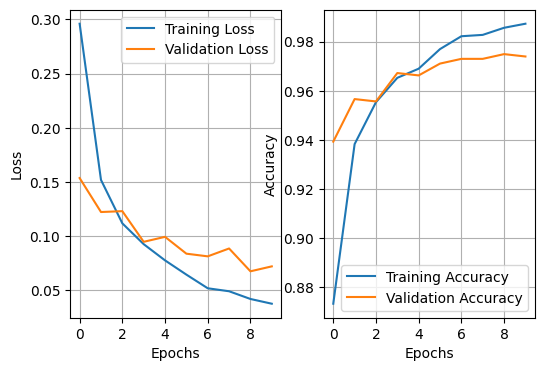

In [298]:
# plot training history 
plt.figure(1, figsize = (6, 4))
plt.subplot(1,2,1)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.plot( history.history["loss"], label = "Training Loss")
plt.plot( history.history["val_loss"], label = "Validation Loss")
plt.grid(True)
plt.legend()

plt.subplot(1,2,2)
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.plot( history.history["acc"], label = "Training Accuracy")
plt.plot( history.history["val_acc"], label = "Validation Accuracy")
plt.grid(True)
plt.legend()

In [297]:
# model evaluation
model.evaluate(X_test, y_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 38s 579ms/step - acc: 0.9674 - loss: 0.0946


[0.08587031066417694, 0.970588207244873]

In [299]:
# reload fitted model
VGG16 = load_model('./Final_Models/VGG16.h5')

C:\Users\User\AppData\Roaming\Python\Python311\site-packages\keras\src\optimizers\base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


In [300]:
# generate predictions
y_pred_VGG16 = VGG16.predict(X_test)

65/65 ━━━━━━━━━━━━━━━━━━━━ 37s 571ms/step


In [301]:
# print classification report
print(classification_report(y_test, y_pred_VGG16.round()))

              precision    recall  f1-score   support

           0       0.83      0.91      0.87       883
           1       0.93      0.86      0.89      1191

    accuracy                           0.88      2074
   macro avg       0.88      0.89      0.88      2074
weighted avg       0.89      0.88      0.88      2074



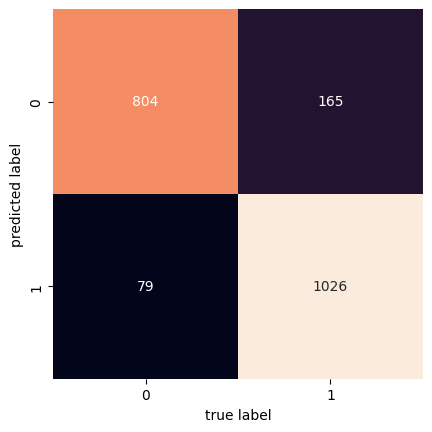

In [302]:
# plot the confusion matrix
mat = confusion_matrix(y_test, y_pred_VGG16.round())
sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False)
plt.xlabel('true label')
plt.ylabel('predicted label');

### Performance Comparison

In [340]:
params = [33.6,56.5,42]
accuracy = [92,86,96]
precision = [83,96,93]
recall = [72,99,86]
f1 = [77,97,89]
runtime = [58,37,28]
modelnames = ["CNN1","CNN2","VGG16"]

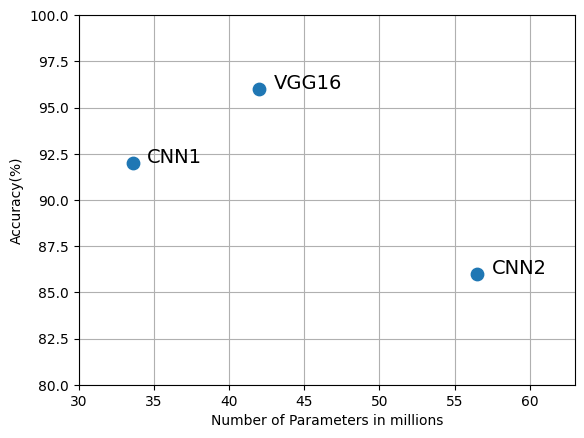

In [344]:
# plot accuracy vs number of params
plt.scatter(params, accuracy, s=80)
plt.ylim(80, 100)
plt.xlim(30, 63)
plt.grid()
plt.xlabel("Number of Parameters in millions")
plt.ylabel("Accuracy(%)")
plt.annotate("CNN1", (33.6, 92), xytext=(34.5,92),fontsize=14)
plt.annotate("CNN2", (56.5, 86), xytext=(57.5,86),fontsize=14)
plt.annotate("VGG16", (42, 96), xytext=(43,96),fontsize=14)
plt.show()

In [307]:
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("Runtime(min)")
  plt.show()

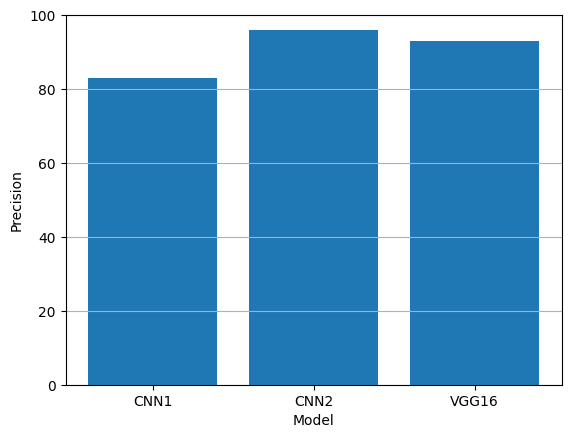

In [351]:
# Plot precision
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("Precision")
  plt.show()
bar_plot(precision,modelnames)

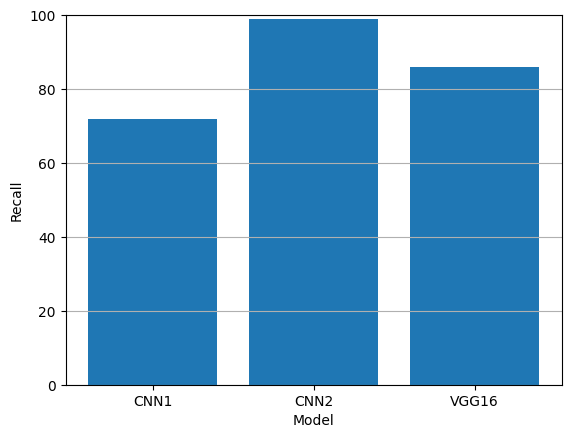

In [352]:
# plot recall
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("Recall")
  plt.show()
bar_plot(recall,modelnames)

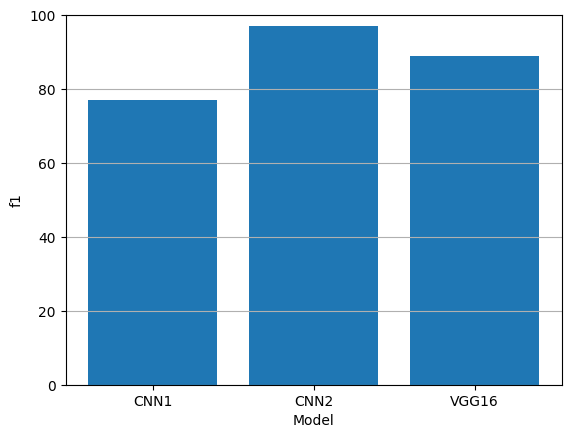

In [354]:
# plot f1 score
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("f1")
  plt.show()
bar_plot(f1,modelnames)

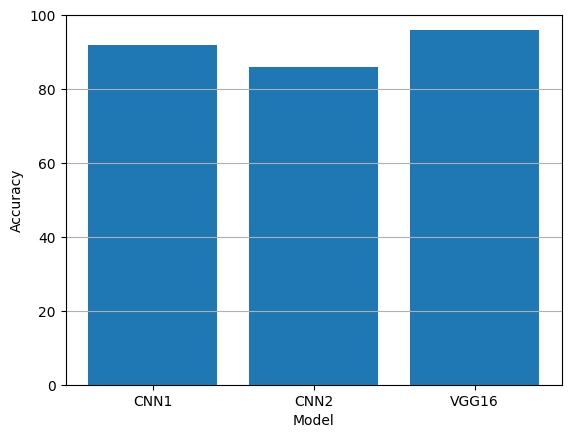

In [355]:
# plot accuracy
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("Accuracy")
  plt.show()
bar_plot(accuracy,modelnames)

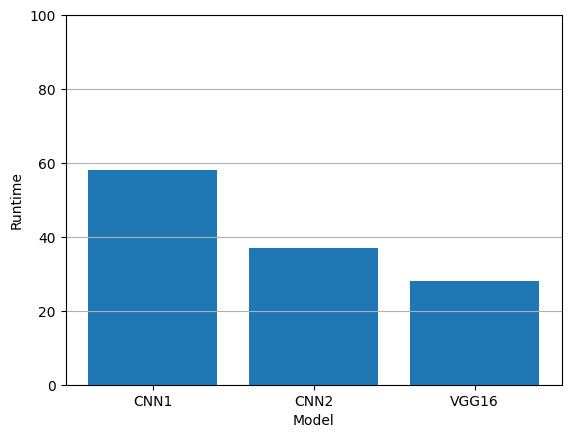

In [356]:
# plot runtime
def bar_plot(metric,labels):
  '''
  Plots a bar chart for a given metrics across the given models
  '''
  plt.figure()
  plt.bar(range(len(labels)), metric)
  plt.ylim(0, 100)
  plt.grid(axis='y')
  plt.xticks(range(len(labels)), labels)
  plt.xlabel("Model")
  plt.ylabel("Runtime")
  plt.show()
bar_plot(runtime,modelnames)